In [1]:
import os

import numpy as np
import numpy.ma as ma
import pandas as pd
import geopandas as gpd
import seaborn as sns

import rasterio
import rasterio.plot
from rasterio.enums import Resampling

import shapely
from shapely.geometry.point import Point

from matplotlib import pyplot as plt
from matplotlib.path import Path
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib import gridspec as gridspec
import matplotlib.patheffects as patheffects

import contextily as cx
from tqdm import tqdm

import IR_processing_utils

plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['font.size'] = 7

In [6]:
#path2areas = r'D:\!Work\! Projects\2024- Плейстоценовый парк\ploshadki\ploshadki_park.shp'
#path2areas = r"D:\!Work\! Projects\2024- Плейстоценовый парк\park_shp_new\ploshadki_park_new.shp"
path2areas = r"D:\!Work\! Projects\2024- Плейстоценовый парк\ploshadki_pol_new\ploshadki_pol_new.shp"



# path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs\DJI_202404210937_006_Pleystocen-IR_t3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs\DJI_202404211121_009_Pleystocen-IRb_t3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs\DJI_202404221002_011_Pleystocen-IR3.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs\DJI_202404221002_011_Pleystocen-IR3_t3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs\DJI_202404221218_016_Pleystocen-IR3b.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs\DJI_202404221218_016_Pleystocen-IR3b_t3dt.tif"]

# path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404210937_006_Pleystocen-IR_emis1_L3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404210937_006_Pleystocen-IR_emis1_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404210937_006_Pleystocen-IR_emis1_t3431.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404210937_006_Pleystocen-IR_emis1_t3431dt.tif",
                   
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404211121_009_Pleystocen-IRb_emis1_L3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404211121_009_Pleystocen-IRb_emis1_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404211121_009_Pleystocen-IRb_emis1_t3431.tif",
                                      
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221002_011_Pleystocen-IR3_emis1_L3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221002_011_Pleystocen-IR3_emis1_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221002_011_Pleystocen-IR3_emis1_t3431.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221002_011_Pleystocen-IR3_emis1_t3431dt.tif",
                   
                   
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221218_016_Pleystocen-IR3b_emis1_L3dt.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221218_016_Pleystocen-IR3b_emis1_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221218_016_Pleystocen-IR3b_emis1_t3431.tif",
                   
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404231239_024_Pleystocen-IR3_emis1_L3dt.tif", 
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404231239_024_Pleystocen-IR3_emis1_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404231239_024_Pleystocen-IR3_emis1_t3431.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404231239_024_Pleystocen-IR3_emis1_t3431dt.tif"]


# path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404210937_006_Pleystocen-IR_emis1_L3dt_geocorr.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404211121_009_Pleystocen-IRb_emis1_L3dt_geocorr.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221002_011_Pleystocen-IR3_emis1_L3dt_geocorr.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404221218_016_Pleystocen-IR3b_emis1_L3dt_geocorr.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new\DJI_202404231239_024_Pleystocen-IR3_emis1_L3dt_geocorr.tif"]




# path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3_t31.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3_t3431.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3_t3431new.tif",

#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3b_t31.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3b_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_day_IR3b_t3431new.tif",

#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3_t31.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3_t32.tif", 
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3_t3431new.tif", 
                    
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3b_t31.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3b_t32.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3b_t3143.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs\1208_evn_IR3b_t3143new.tif"]

# path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3_t32_georefer.tif", 
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3_t3431new_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3b_t32_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3b_t3431new_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_evn_IR3_t32_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_evn_IR3_t3431new_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_evn_IR3b_t32_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_evn_IR3b_t3431new_georefer.tif"]


# path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404210937_006_Pleystocen-IR_emis1_t3431dt_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404221002_011_Pleystocen-IR3_emis1_t3431dt_georefer.tif",
#                    r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404231239_024_Pleystocen-IR3_emis1_t3431dt_georefer.tif"]

path2IR_rasters = [r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404221002_011_Pleystocen-IR3_emis1_t3431dt_georefer.tif",
                   r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404221218_016_Pleystocen-IR3b_emis1_t3431_modified.tif",
                   r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404231239_024_Pleystocen-IR3_emis1_t3431dt_georefer.tif",
                   #r"G:\! Data\IFA\! campaigns\202404 Pleistocene Park\IR_mavic3\geotiffs_new_georefer\DJI_202404231239_024_Pleystocen-IR3_emis1_t3431dt_georefer.tif",
                   r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3_t3431new_modified.tif",
                   r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3b_t32_georefer.tif",
                   #r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3_t3431new_georefer_modified.tif",
                   #r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_day_IR3b_t32_georefer.tif",
                   r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_evn_IR3_t3431new_georefer.tif",
                   r"G:\! Data\IFA\! campaigns\202408 Pleistocene Park\IR_Mavic3\geotifs_georefer\1208_evn_IR3b_t3431new_georefer.tif",
                   ]

survey_names = ['Spring (22.04), midday v1', 
                'Spring (22.04), midday v2', 
                'Spring (23.04), midday v1', 
                'Summer (12.08), midday v1',
                'Summer (12.08), midday v2',
                'Summer (12.08), evening v1',
                'Summer (12.08), evening v2']                   


polygons = gpd.read_file (path2areas)
polygons['coords'] = polygons['geometry'].apply(lambda x: x.representative_point().coords[:])
polygons['coords'] = [coords[0] for coords in polygons['coords']]
polygons['extent'] = [[p.bounds[0], p.bounds[2], p.bounds[1], p.bounds[3]] for p in polygons['geometry']]
polygons = polygons.sort_values(by='num_str')


In [7]:


rasters = []

for i, path in enumerate(path2IR_rasters):

    raster = {}

    display(path)

    src = rasterio.open(path)
    
    data = src.read() 
    values = data [0,:,:]
    mask = data [1,:,:]

    n = np.sum (mask > 0)
    #display(n)
    

    raster['fname'] = os.path.basename(path)
    raster['name'] = survey_names[i]
    raster['values'] = ma.masked_array(values, ~mask.astype(bool))
    raster['extent'] = (src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top)
    raster['lons'], raster['lats'] =  IR_processing_utils.get_subarray_coords_rio (values.shape, src.crs, src.transform)
    raster['vmin2draw'] = np.nanpercentile(raster['values'].copy().filled(np.nan).flatten(), 1)
    raster['vmax2draw'] = np.nanpercentile(raster['values'].copy().filled(np.nan).flatten(), 99) #np.percentile(np.copy(raster['values'].flatten()), 99)
    rasters.append(raster)
    #break

'G:\\! Data\\IFA\\! campaigns\\202404 Pleistocene Park\\IR_mavic3\\geotiffs_new_georefer\\DJI_202404221002_011_Pleystocen-IR3_emis1_t3431dt_georefer.tif'

'G:\\! Data\\IFA\\! campaigns\\202404 Pleistocene Park\\IR_mavic3\\geotiffs_new_georefer\\DJI_202404221218_016_Pleystocen-IR3b_emis1_t3431_modified.tif'

'G:\\! Data\\IFA\\! campaigns\\202404 Pleistocene Park\\IR_mavic3\\geotiffs_new_georefer\\DJI_202404231239_024_Pleystocen-IR3_emis1_t3431dt_georefer.tif'

'G:\\! Data\\IFA\\! campaigns\\202408 Pleistocene Park\\IR_Mavic3\\geotifs_georefer\\1208_day_IR3_t3431new_modified.tif'

'G:\\! Data\\IFA\\! campaigns\\202408 Pleistocene Park\\IR_Mavic3\\geotifs_georefer\\1208_day_IR3b_t32_georefer.tif'

'G:\\! Data\\IFA\\! campaigns\\202408 Pleistocene Park\\IR_Mavic3\\geotifs_georefer\\1208_evn_IR3_t3431new_georefer.tif'

'G:\\! Data\\IFA\\! campaigns\\202408 Pleistocene Park\\IR_Mavic3\\geotifs_georefer\\1208_evn_IR3b_t3431new_georefer.tif'

In [8]:
min_lon = np.min([r['extent'][0] for r in rasters])
max_lon = np.max([r['extent'][1] for r in rasters])
min_lat = np.min([r['extent'][2] for r in rasters])
max_lat = np.max([r['extent'][3] for r in rasters])

ir_lon_lim = np.array([min_lon - 0.005 * (max_lon - min_lon), max_lon + 0.005 * (max_lon - min_lon)])
ir_lat_lim = np.array([min_lat - 0.01 * (max_lat - min_lat), max_lat + 0.01 * (max_lat - min_lat)])



In [9]:
polygon_stats = pd.DataFrame()
temp4polygons = {}
temp4polygons_df = pd.DataFrame()

min_pixels = 40000
    
for i_r, raster in enumerate (tqdm (rasters)):
    cur_raster_stats = {}
    cur_raster_stats['name'] = raster['name']
    cur_raster_stats['q01'] = np.percentile (raster['values'].data[raster['values'].mask == 0], 1)
    cur_raster_stats['q99'] = np.percentile (raster['values'].data[raster['values'].mask == 0], 99)
    
    for idx, row in polygons.iterrows():
        polygon = polygons['geometry'][idx]
        mpath = Path(np.transpose(polygon.exterior.xy)) # the vertices of the polygon
        #x_mesh, y_mesh = np.meshgrid(raster['lons'], raster['lats'])
        xy_mesh = np.dstack((raster['lons'], raster['lats']))
        xy_mesh_flat = xy_mesh.reshape((-1, 2))

        polygon_mask = mpath.contains_points(xy_mesh_flat).reshape(raster['values'].shape)
        
        cur_temp = raster['values'].copy()
        cur_temp = raster['values'].filled(np.nan)
        cur_temp[~polygon_mask] = np.nan
        cur_temp = cur_temp[~np.isnan(cur_temp)].flatten()

        #display (len (cur_temp))
        print (f'{raster['name']}, {row.num_str}, {len (cur_temp)}')

        temp4polygons[raster['name'] + '_t'+ row.num_str] = cur_temp
        temp4polygons[raster['name'] + '_t'+ row.num_str] = cur_temp


       
        #cur_raster_stats['t_median' + row.num_str] = np.median (cur_temp) if len (cur_temp) > 1 else np.nan
        cur_raster_stats[row.num_str + '_mean'] = np.nanmean (cur_temp) if len (cur_temp) > min_pixels else np.nan
        cur_raster_stats[row.num_str + '_std']  = np.nanstd (cur_temp) if len (cur_temp) > min_pixels else np.nan
        cur_raster_stats[row.num_str + 'q1']    = np.percentile (cur_temp, 1) if len (cur_temp) > min_pixels else np.nan
        cur_raster_stats[row.num_str + 'q99']   = np.percentile (cur_temp, 99) if len (cur_temp) > min_pixels else np.nan
        
        cur_temp_df = pd.DataFrame(cur_temp, columns = ['temp'])
        cur_temp_df['temp_anom'] = cur_temp - cur_raster_stats['1_mean']
        cur_temp_df['Polygon'] = row.num_str
        cur_temp_df['Survey'] = raster['name']
        if len (cur_temp) > min_pixels: temp4polygons_df = pd.concat((temp4polygons_df, cur_temp_df), axis = 0)

    polygon_stats = pd.concat((polygon_stats, pd.DataFrame(cur_raster_stats, index = [i_r])),axis=0)
    
display(polygon_stats)


  0%|          | 0/7 [00:00<?, ?it/s]

Spring (22.04), midday v1, 1, 798587
Spring (22.04), midday v1, 2a, 263171
Spring (22.04), midday v1, 2b, 483288
Spring (22.04), midday v1, 3, 119529
Spring (22.04), midday v1, 4, 0
Spring (22.04), midday v1, 5, 0


 14%|█▍        | 1/7 [00:11<01:10, 11.75s/it]

Spring (22.04), midday v1, 6, 0
Spring (22.04), midday v2, 1, 837894
Spring (22.04), midday v2, 2a, 276121
Spring (22.04), midday v2, 2b, 507083
Spring (22.04), midday v2, 3, 34197
Spring (22.04), midday v2, 4, 0
Spring (22.04), midday v2, 5, 0


C:\Users\mvar9\AppData\Local\Temp\ipykernel_1872\3712697221.py:47: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  polygon_stats = pd.concat((polygon_stats, pd.DataFrame(cur_raster_stats, index = [i_r])),axis=0)
 29%|██▊       | 2/7 [00:25<01:03, 12.72s/it]

Spring (22.04), midday v2, 6, 0
Spring (23.04), midday v1, 1, 844618
Spring (23.04), midday v1, 2a, 278331
Spring (23.04), midday v1, 2b, 511138
Spring (23.04), midday v1, 3, 115444
Spring (23.04), midday v1, 4, 0
Spring (23.04), midday v1, 5, 0


 43%|████▎     | 3/7 [00:33<00:43, 10.86s/it]

Spring (23.04), midday v1, 6, 0
Summer (12.08), midday v1, 1, 655702
Summer (12.08), midday v1, 2a, 216074
Summer (12.08), midday v1, 2b, 396807
Summer (12.08), midday v1, 3, 251173
Summer (12.08), midday v1, 4, 0
Summer (12.08), midday v1, 5, 0


 57%|█████▋    | 4/7 [00:42<00:29,  9.99s/it]

Summer (12.08), midday v1, 6, 0
Summer (12.08), midday v2, 1, 748599
Summer (12.08), midday v2, 2a, 246691
Summer (12.08), midday v2, 2b, 453032
Summer (12.08), midday v2, 3, 129784
Summer (12.08), midday v2, 4, 0
Summer (12.08), midday v2, 5, 0


 71%|███████▏  | 5/7 [00:50<00:18,  9.40s/it]

Summer (12.08), midday v2, 6, 0
Summer (12.08), evening v1, 1, 682837
Summer (12.08), evening v1, 2a, 225018
Summer (12.08), evening v1, 2b, 413229
Summer (12.08), evening v1, 3, 261939
Summer (12.08), evening v1, 4, 0
Summer (12.08), evening v1, 5, 0


 86%|████████▌ | 6/7 [00:58<00:08,  8.85s/it]

Summer (12.08), evening v1, 6, 0
Summer (12.08), evening v2, 1, 545394
Summer (12.08), evening v2, 2a, 267747
Summer (12.08), evening v2, 2b, 491692
Summer (12.08), evening v2, 3, 136354
Summer (12.08), evening v2, 4, 0
Summer (12.08), evening v2, 5, 0


100%|██████████| 7/7 [01:06<00:00,  9.47s/it]

Summer (12.08), evening v2, 6, 0


,name,q01,q99,1_mean,1_std,1q1,1q99,2a_mean,2a_std,2aq1,...,4q1,4q99,5_mean,5_std,5q1,5q99,6_mean,6_std,6q1,6q99
0,"Spring (22.04), midday v1",-8.746133,0.032752,-5.148783,1.525480,-7.961798,-1.561359,-5.487825,1.054675,-7.254528,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"Spring (22.04), midday v2",-8.491949,-0.495510,-5.485434,1.367977,-7.985513,-2.189995,-6.362283,0.909735,-7.805816,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"Spring (23.04), midday v1",-11.169316,-3.011585,-8.222692,1.199890,-10.408715,-5.196280,-8.614125,1.131039,-10.434789,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"Summer (12.08), midday v1",11.603301,20.712313,17.959051,0.850799,15.532407,19.973770,17.375761,0.456385,16.369848,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"Summer (12.08), midday v2",11.225324,19.935724,17.695385,0.873410,15.415506,19.727173,17.168411,0.453634,16.171139,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,"Summer (12.08), evening v1",14.009596,18.459305,16.935509,0.470318,15.901574,17.819841,16.421560,0.254466,15.910086,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,"Summer (12.08), evening v2",13.772008,18.544386,15.853614,1.063609,14.023246,17.546709,15.558462,0.454530,14.496624,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


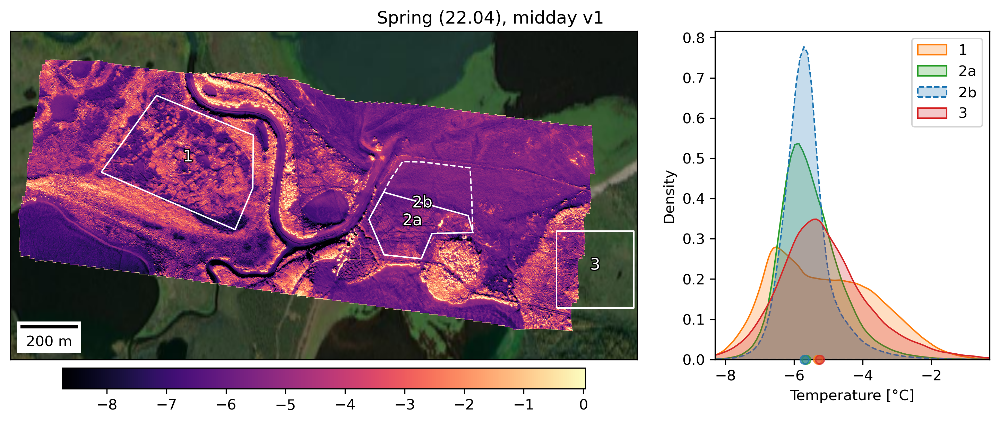

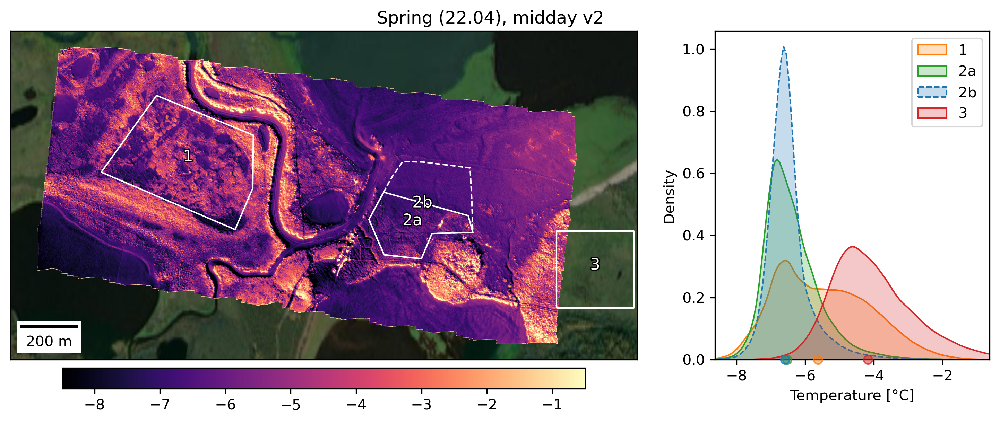

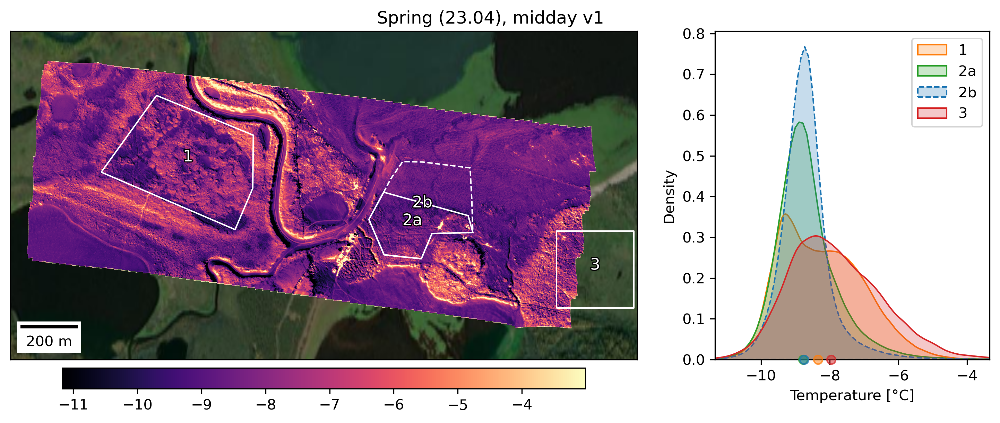

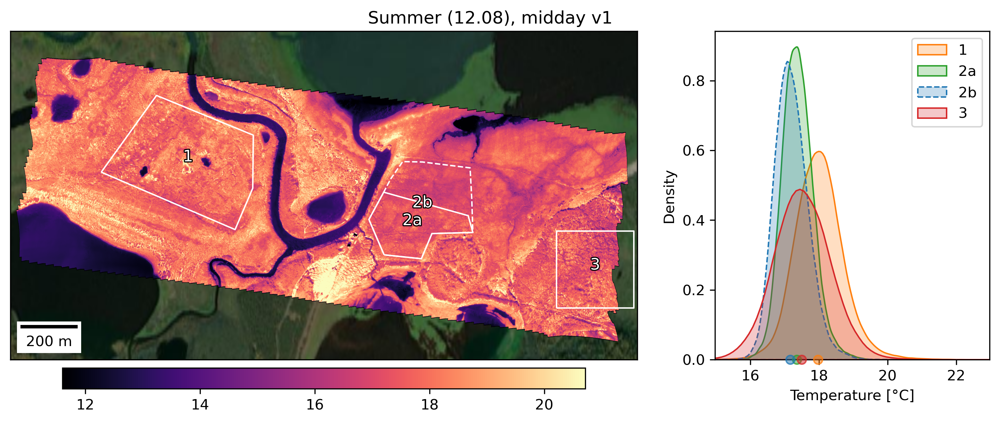

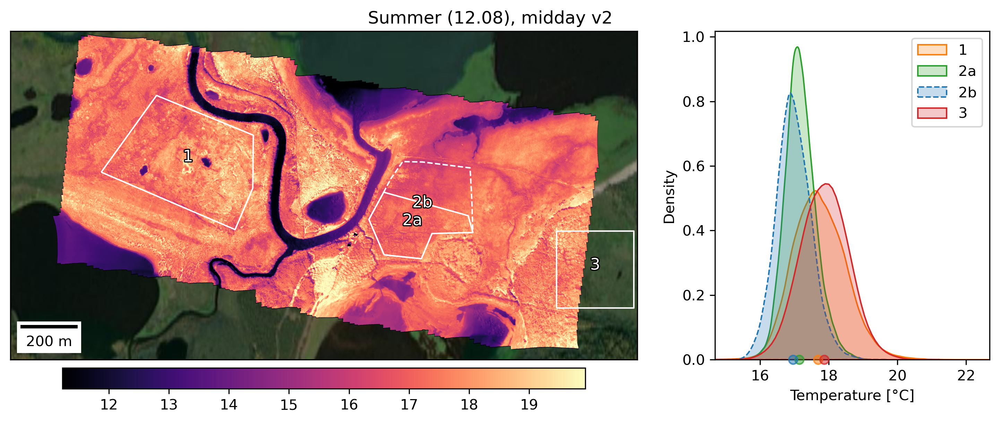

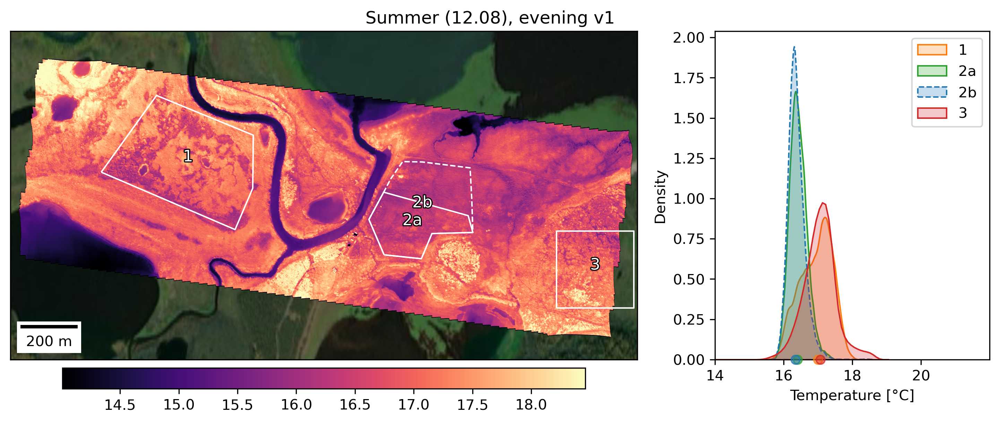

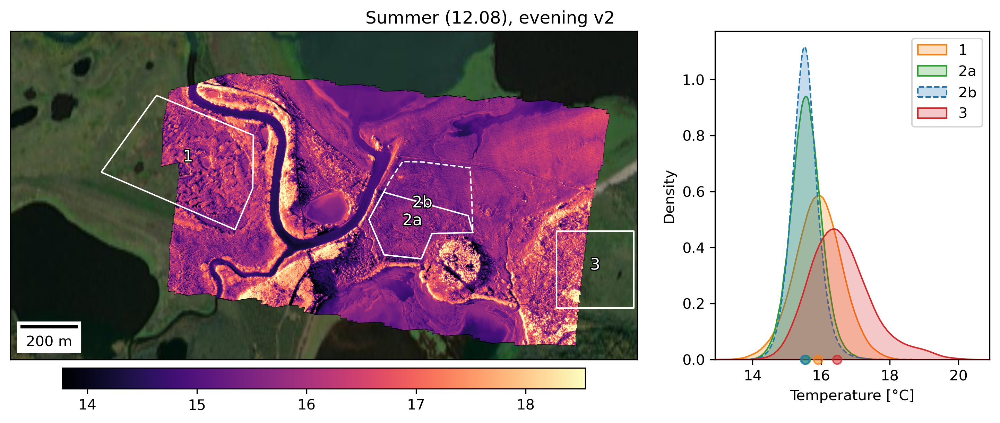

In [11]:
plt.rcParams['font.size'] = 10
pics_dir = 'pics_IR_new_georef4paper'
if not os.path.isdir (pics_dir):
    os.mkdir(pics_dir)

colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
colors[0], colors[1] = colors[1], colors[0]
colors[1], colors[2] = colors[2], colors[1]


#colors = ['red', 'green', 'orange', 'green']

for i, raster in enumerate (rasters):

    #if 'modified' not in raster['fname']:
    #    continue

    fig = plt.figure(figsize = (10, 4))

    plt.subplots_adjust(left=0.01, right=0.98, bottom=0.14, top=0.93, wspace=0.1, hspace=0.01)

    gs = gridspec.GridSpec(1, 2, width_ratios=[2.5, 1]) 
    ax = [fig.add_subplot(g) for g in gs]
    ax[0].set_xticks([])
    ax[0].set_yticks([])

    plt.sca(ax[0])

    plt.xlim(ir_lon_lim)
    plt.ylim(ir_lat_lim)
    try:
        cx.add_basemap(plt.gca(), source = cx.providers.Esri.WorldImagery, crs = 4326, attribution_size = 2, attribution = '')              
    except Exception as err:
        print ('basemap is not availible')

    im = plt.imshow (raster['values'], extent= raster['extent'], vmin=raster['vmin2draw'], vmax=raster['vmax2draw'], cmap = 'magma')
    for idx, row in polygons.iterrows():
        polygons.loc[idx:idx].plot (edgecolor = 'white', facecolor = 'None', ax = plt.gca(), linestyle = '--' if row.num_str == '2b' else '-')
        #plt.plot (*polygons.exterior[idx].xy, color = 'white', linestyle = '--' if row.name == '2b' else '-')
    
        plt.annotate(text=row.num_str, xy = (shapely.centroid (row.geometry).x, shapely.centroid (row.geometry).y), #xy=row['coords'],
                    horizontalalignment='center', fontsize = 11, color = 'white', 
                    path_effects=[patheffects.withStroke(linewidth=1.5, foreground='black', capstyle="round")]) 
                          
    
    points = gpd.GeoSeries([Point(161, ir_lat_lim.mean()), Point(162, ir_lat_lim.mean())], crs=4326)  # Geographic WGS 84 - degrees
    points = points.to_crs(32619)
    distance_meters = points[0].distance(points[1])

    scalebar = ScaleBar(distance_meters, length_fraction=0.2, location = 'lower left', pad = 0.2, border_pad = 0.5, rotation='horizontal-only') #, units = "km", )
    
    plt.gca().add_artist(scalebar)                     

    pos = ax[0].get_position().bounds

    cbar_ax = fig.add_axes([pos[0]+0.05, pos[1]-0.07, pos[2]-0.1, 0.05])

    plt.colorbar(im, cax = cbar_ax, orientation='horizontal', shrink = 0.6)
    
    
    plt.sca(ax[1])
    
    for i, key in enumerate ([x for x in temp4polygons.keys() if raster['name'] in x]):
        if len(temp4polygons[key]) < 1:
            continue
        p = sns.kdeplot(temp4polygons[key], ax = ax[1], fill=True, 
                        color = colors[i], #colors[i-1] if '2b' in key else 
                        linestyle = '--' if '2b' in key else '-',
                        label=key.split('_')[-1].replace('t', ''))
        plt.plot(np.median(temp4polygons[key]), 0, 'o', color = colors[i], clip_on = False, zorder=99, alpha = 0.5)
        plt.plot(np.median(temp4polygons[key]), 0, 'o', color = colors[i], clip_on = False, zorder=99, markerfacecolor='none', alpha = 0.5)
    
    y_lim = plt.ylim()

    plt.xlabel('Temperature [°C]')
    plt.legend()

    ctrl_t = np.median(temp4polygons[raster['name'] + '_t1']) #.median()
    
    #plt.ylim([-0.05, 0.05])
    plt.xlim([ctrl_t-3, ctrl_t+5])
    # if '1208_' in raster['fname']:
    #     plt.xlim([12,22])
    # else:
    #     plt.xlim([-11,-1])
    
    plt.suptitle (raster['name'])

    #break
    plt.savefig (pics_dir + '/' + raster['name'] + '_new.png')


#sys.exit()

In [51]:
temp4polygons_df.columns

Index(['temp', 'temp_anom', 'Polygon', 'Survey'], dtype='object')

C:\Users\mvar9\AppData\Local\Temp\ipykernel_1872\925584667.py:6: UserWarning: The palette list has more values (10) than needed (4), which may not be intended.
  ax = sns.boxplot (data=temp4polygons_df, y = 'Survey', x = 'temp_anom', hue='Polygon', showfliers=False, palette = colors)


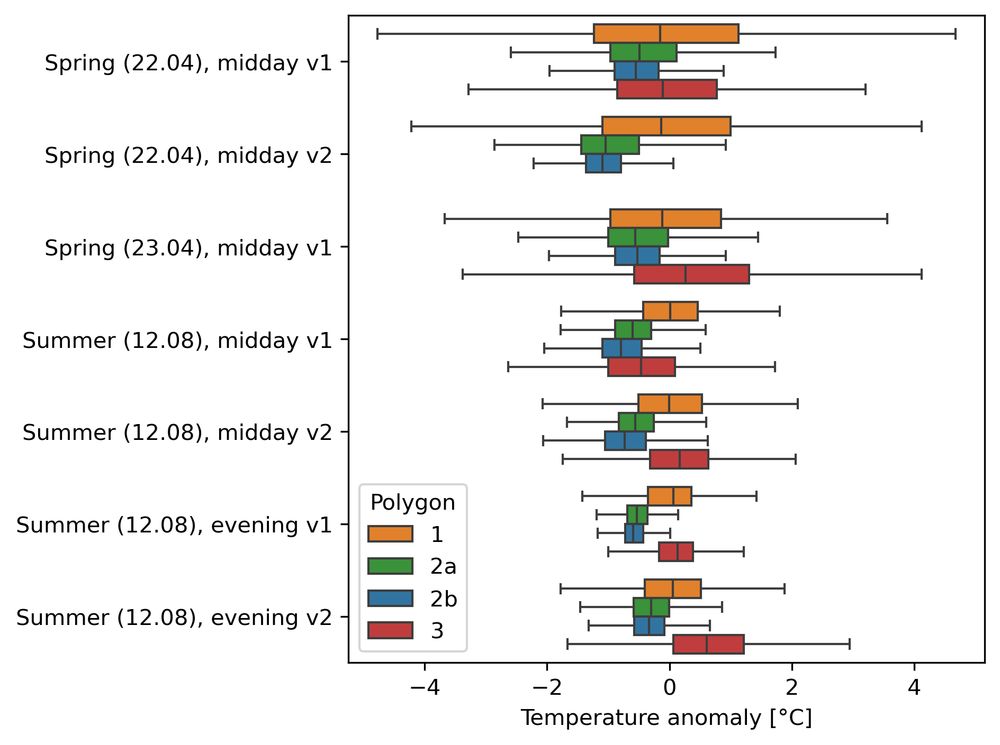

In [12]:
#temp4polygons_df.shape
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
colors[0], colors[1] = colors[1], colors[0]
colors[1], colors[2] = colors[2], colors[1]

ax = sns.boxplot (data=temp4polygons_df, y = 'Survey', x = 'temp_anom', hue='Polygon', showfliers=False, palette = colors)
ax.set_xlabel ('Temperature anomaly [°C]')
ax.set_ylabel ('') 
plt.tight_layout()
plt.savefig (pics_dir + '/boxplots_v2.png')


In [9]:
polygon_stats.to_csv ('polygon_stats4paper.csv', sep = ';')